In [1]:
import os
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import json
import tangram as tg

/gstore/home/tripaa18/miniconda3/envs/tangram-env/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def make_anndata(dir_path, sample_id):
    # path to sample
    sample_path = os.path.join(dir_path, sample_id, 'filtered_feature_bc_matrix.h5')
    # read the h5 file
    adata = sc.read_10x_h5(sample_path)
    # read obs from csv separately
    obs = pd.read_csv(os.path.join(dir_path, sample_id, 'spatial', 'tissue_positions_list.csv'), header=None)
    obs.columns = ['barcode','in_tissue', 'array_row', 'array_column', 'pxl_row_in_fullres', 'pxl_col_in_fullres']
    obs.set_index('barcode', inplace=True)
    # select only spot overlapping with the tissue
    obs = obs[obs.in_tissue == 1]
    # add obs to anndata
    adata.obs = adata.obs.join(obs)
    # add pixel positions to spatial in obsm
    adata.obsm['spatial'] = adata.obs[['pxl_col_in_fullres', 'pxl_row_in_fullres']].to_numpy()
    # drop above from obs
    adata.obs.drop(['in_tissue','pxl_col_in_fullres','pxl_row_in_fullres'],axis=1,inplace=True)
    # rename row and column coordinates
    adata.obs.rename(columns={'array_row':'y', 'array_column':'x'},inplace=True)
    # add hires image to adata to use sc plotting
    hires_image = plt.imread(os.path.join(dir_path, sample_id, 'spatial', 'tissue_hires_image.png'))
    adata.uns['spatial'] = dict()
    adata.uns['spatial'][sample_id] = dict()
    adata.uns['spatial'][sample_id]['images']= dict()
    adata.uns['spatial'][sample_id]['images']['hires'] = hires_image
    # add scalefactors to image
    f = open(os.path.join(dir_path, sample_id, 'spatial', 'scalefactors_json.json'))
    adata.uns['spatial'][sample_id]['scalefactors'] = json.load(f)
    return adata

In [3]:
len(os.listdir("/gne/data/"
               "obdroot/zelboraf/co39262/ngs/intermdata/"
               "gne_obd_co39262_scilife_20220421/co39262_exported annotations csv"))

37

In [4]:
st_dir = "/gne/data/obdroot/zelboraf/co39262/ngs/rawdata//scilifelab_obd_co39262_ngs_rna_10x-visium_wts_20220311"

## Inputs

In [5]:
data_path = '/gstore/home/tripaa18/MEL/melanoma-st/priya_analysis/data/'

In [6]:
mapping = pd.read_csv(data_path+'sample_id_mapping_file.csv', sep=',', index_col='visium_id')
mapping.head(2)

,PATIENT_ID,nmf_cluster,tissue_met
visium_id,,,
V11Y03-115_D1/,2206,Undiff_Fib_IRes,METASTATIC
V11M15-037_D1/,2287,Undiff_Fib_IRes,METASTATIC


In [7]:
sample_list = [d for d in os.listdir(st_dir) if os.path.isdir(os.path.join(st_dir, d))]
sample_list[0]

'V11M15-033_C1'

In [8]:
nmf_coeffs = pd.read_csv(data_path + 'nmf150_H.csv', sep=',', index_col=0)
nmf_coeffs['cluster_id'] = nmf_coeffs.index.map(lambda x: 'V'+str(x))
nmf_coeffs = nmf_coeffs.set_index('cluster_id')
nmf_coeffs.head(2)

,CO39262-294984-2472,CO39262-294986-2469,CO39262-295209-3203,CO39262-295209-3204,CO39262-295210-3200,CO39262-295210-3207,CO39262-295241-3202,CO39262-295241-3205,CO39262-295241-3206,CO39262-295343-3201,...,CO39262-300786-2000,CO39262-300786-2001,CO39262-300786-2004,CO39262-300786-2009,CO39262-300937-2138,CO39262-300937-2146,CO39262-304465-1514,CO39262-304587-2971,CO39262-304587-2974,CO39262-305602-1007
cluster_id,,,,,,,,,,,,,,,,,,,,,
V1,2.946777e-02,0.004093,0.043211,0.119997,0.017096,0.029710,0.066921,0.000876,8.924199e-02,0.206239,...,7.659130e-02,0.160903,0.010032,0.000601,0.028044,0.022137,0.084895,0.019943,0.001255,0.200357
V2,2.220446e-16,0.095493,0.057197,0.041751,0.264143,0.263673,0.122844,0.073729,2.220446e-16,0.015092,...,2.220446e-16,0.004534,0.015386,0.007022,0.027242,0.120432,0.033406,0.000066,0.259836,0.004631


In [9]:
# use NMF `W` as single cell reference
ad_sc = sc.read_h5ad(data_path+'melanoma_nmf_w_1500_norm10k.h5ad')

In [10]:
ad_sc

AnnData object with n_obs × n_vars = 7 × 1500
    obs: 'cluster_id'

V11M15-033_C1 diff_cytoIC CO39262-297203-2231


INFO:root:1358 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1358 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1358 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.098, KL reg: 0.417
Score: 0.158, KL reg: 0.001
Score: 0.160, KL reg: 0.001
Score: 0.161, KL reg: 0.000
Score: 0.161, KL reg: 0.000
Score: 0.162, KL reg: 0.000
Score: 0.162, KL reg: 0.000
Score: 0.162, KL reg: 0.000
Score: 0.162, KL reg: 0.000
Score: 0.162, KL reg: 0.000


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


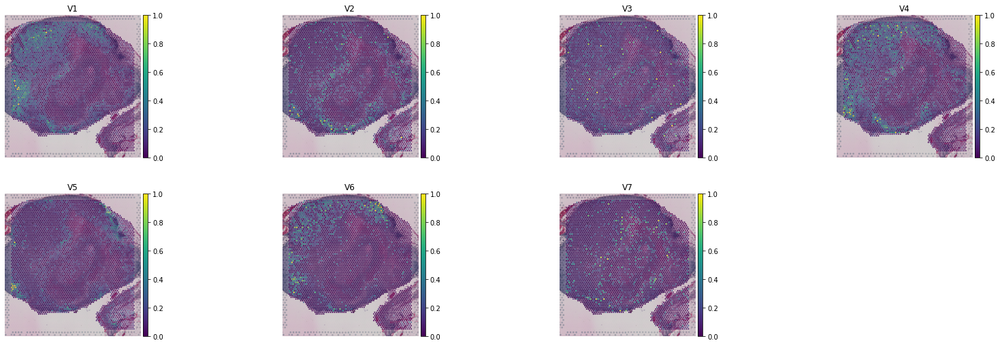

V11M22-348_D1 Undiff_Fib_IRes CO39262-295210-3207


INFO:root:1010 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1010 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1010 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.063, KL reg: 0.589
Score: 0.145, KL reg: 0.002
Score: 0.148, KL reg: 0.001
Score: 0.148, KL reg: 0.001
Score: 0.149, KL reg: 0.001
Score: 0.149, KL reg: 0.001
Score: 0.149, KL reg: 0.001
Score: 0.149, KL reg: 0.001
Score: 0.149, KL reg: 0.001
Score: 0.149, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


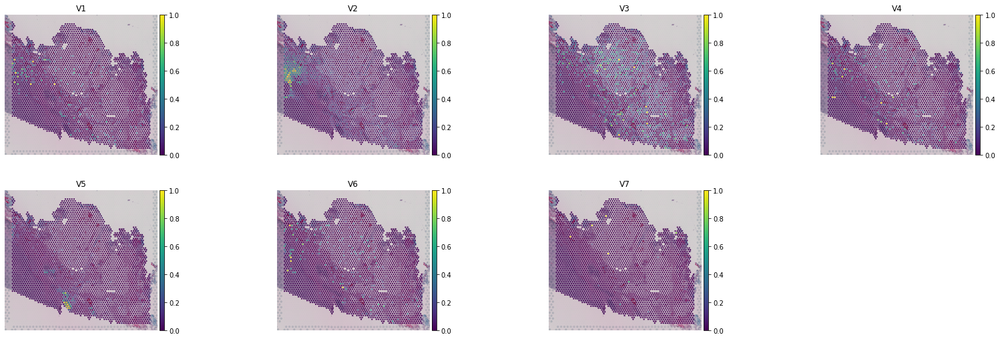

V11M15-037_B1 diff_cytoIC CO39262-300628-3801


INFO:root:1057 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1057 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1057 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.088, KL reg: 0.561
Score: 0.160, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


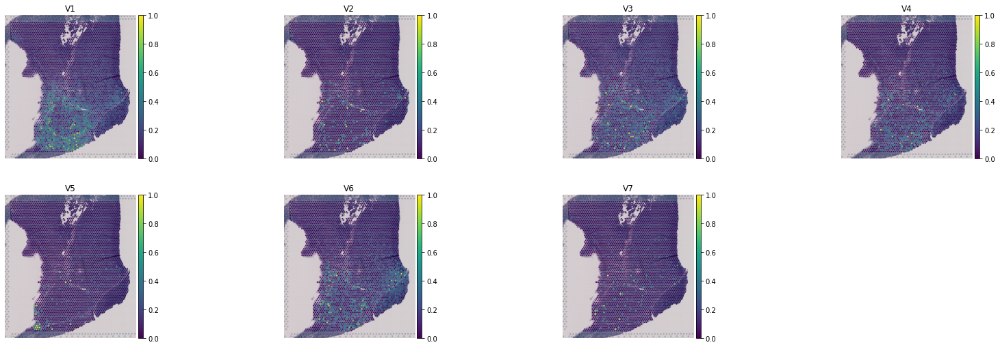

V11M15-037_D1 Undiff_Fib_IRes CO39262-296848-2287


INFO:root:1340 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1340 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1340 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.093, KL reg: 0.837
Score: 0.204, KL reg: 0.001
Score: 0.206, KL reg: 0.001
Score: 0.207, KL reg: 0.001
Score: 0.207, KL reg: 0.001
Score: 0.207, KL reg: 0.001
Score: 0.207, KL reg: 0.001
Score: 0.207, KL reg: 0.001
Score: 0.207, KL reg: 0.001
Score: 0.207, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


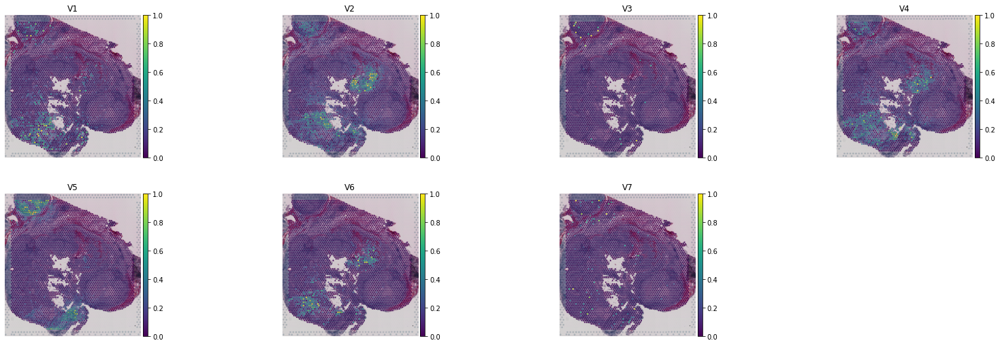

V11Y03-115_B1 diff_cytoIC CO39262-295703-2453


INFO:root:1155 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1155 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1155 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.084, KL reg: 0.535
Score: 0.200, KL reg: 0.004
Score: 0.203, KL reg: 0.003
Score: 0.203, KL reg: 0.003
Score: 0.204, KL reg: 0.003
Score: 0.204, KL reg: 0.003
Score: 0.204, KL reg: 0.003
Score: 0.204, KL reg: 0.003
Score: 0.204, KL reg: 0.003
Score: 0.204, KL reg: 0.003


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


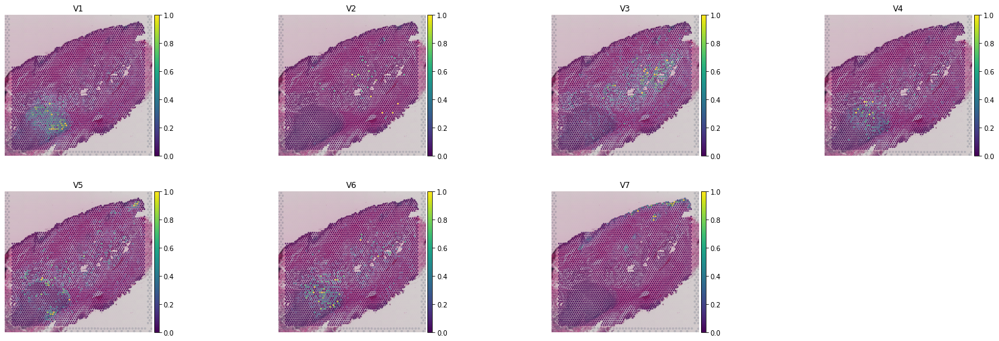

V11L12-058_C1 Undiff_Fib_IRes CO39262-297202-2203


INFO:root:1351 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1351 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1351 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.120, KL reg: 0.296
Score: 0.185, KL reg: 0.002
Score: 0.187, KL reg: 0.002
Score: 0.187, KL reg: 0.002
Score: 0.187, KL reg: 0.002
Score: 0.187, KL reg: 0.002
Score: 0.187, KL reg: 0.002
Score: 0.188, KL reg: 0.002
Score: 0.188, KL reg: 0.002
Score: 0.188, KL reg: 0.002


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


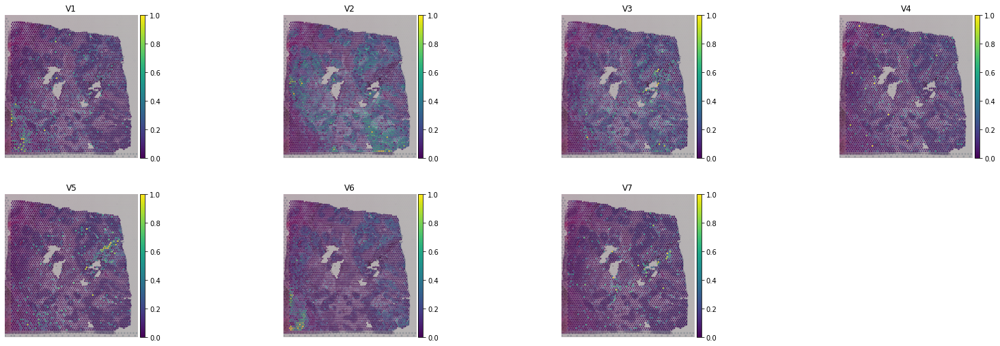

V11M22-347_B1 diff_cytoIC CO39262-300628-3823


INFO:root:1372 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1372 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1372 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.082, KL reg: 0.623
Score: 0.096, KL reg: 0.002
Score: 0.099, KL reg: 0.002
Score: 0.100, KL reg: 0.002
Score: 0.101, KL reg: 0.002
Score: 0.101, KL reg: 0.002
Score: 0.101, KL reg: 0.002
Score: 0.101, KL reg: 0.002
Score: 0.101, KL reg: 0.002
Score: 0.101, KL reg: 0.002


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


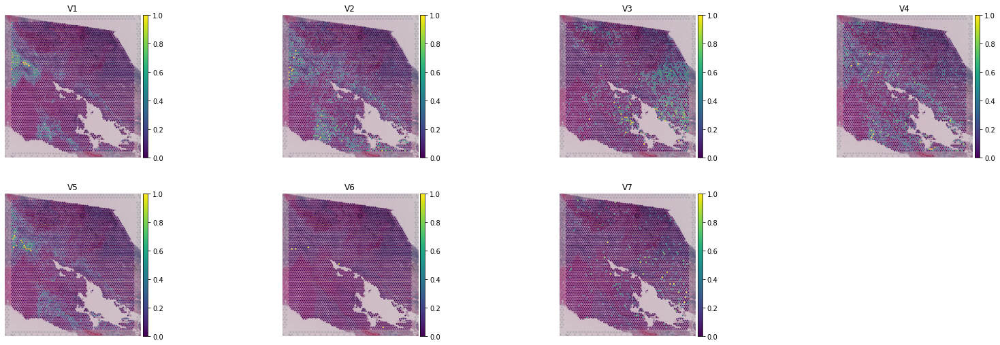

V11Y03-115_D1 Undiff_Fib_IRes CO39262-297202-2206


INFO:root:733 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:733 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 733 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.056, KL reg: 0.704
Score: 0.124, KL reg: 0.002
Score: 0.127, KL reg: 0.001
Score: 0.128, KL reg: 0.001
Score: 0.128, KL reg: 0.001
Score: 0.128, KL reg: 0.001
Score: 0.128, KL reg: 0.001
Score: 0.128, KL reg: 0.001
Score: 0.128, KL reg: 0.001
Score: 0.128, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


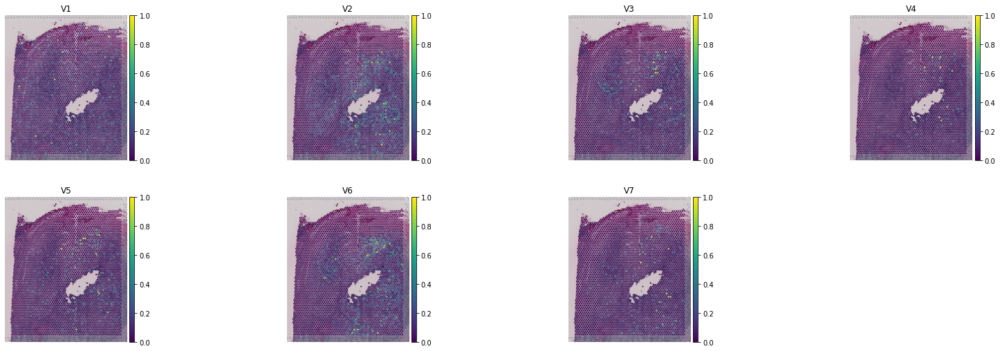

V11L12-114_D1 diff_cytoIC CO39262-297047-1516


INFO:root:950 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:950 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 950 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.079, KL reg: 0.340
Score: 0.133, KL reg: 0.001
Score: 0.134, KL reg: 0.001
Score: 0.134, KL reg: 0.001
Score: 0.134, KL reg: 0.001
Score: 0.135, KL reg: 0.001
Score: 0.135, KL reg: 0.001
Score: 0.135, KL reg: 0.001
Score: 0.135, KL reg: 0.001
Score: 0.135, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


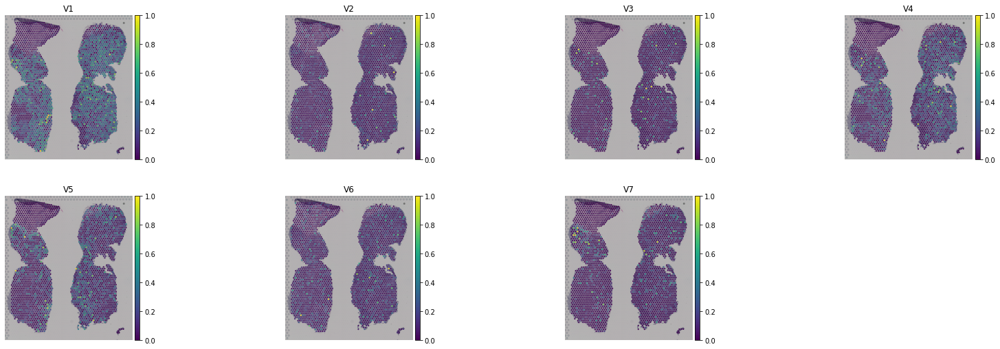

V11L12-114_A1 diff_cytoIC CO39262-300631-3839


INFO:root:1350 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1350 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1350 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.107, KL reg: 0.321
Score: 0.178, KL reg: 0.001
Score: 0.180, KL reg: 0.001
Score: 0.180, KL reg: 0.001
Score: 0.180, KL reg: 0.001
Score: 0.180, KL reg: 0.001
Score: 0.181, KL reg: 0.001
Score: 0.181, KL reg: 0.001
Score: 0.181, KL reg: 0.001
Score: 0.181, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


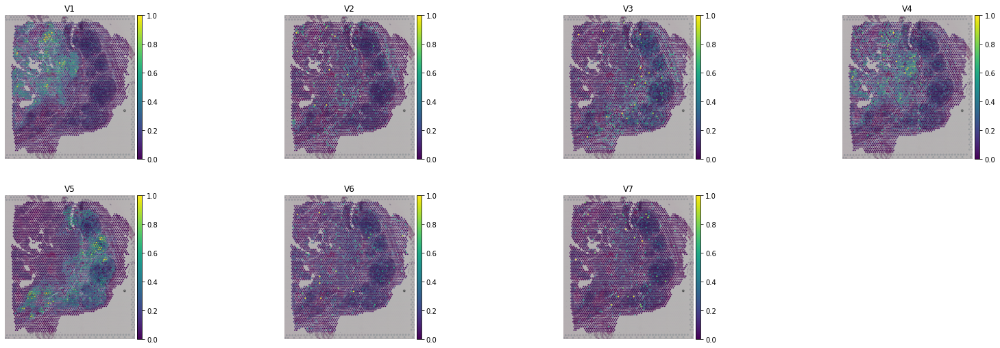

V11M22-348_A1 diff_cytoIC CO39262-295487-2966


INFO:root:1341 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1341 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1341 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.069, KL reg: 0.466
Score: 0.118, KL reg: 0.001
Score: 0.120, KL reg: 0.001
Score: 0.120, KL reg: 0.001
Score: 0.121, KL reg: 0.001
Score: 0.121, KL reg: 0.001
Score: 0.121, KL reg: 0.001
Score: 0.121, KL reg: 0.001
Score: 0.121, KL reg: 0.001
Score: 0.121, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


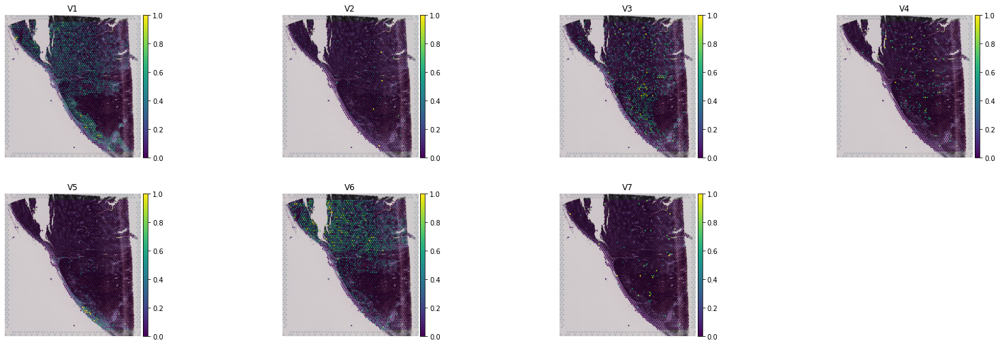

V11M15-037_C1 diff_cytoIC CO39262-295701-2435


INFO:root:1203 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1203 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1203 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.088, KL reg: 0.399
Score: 0.141, KL reg: 0.001
Score: 0.144, KL reg: 0.001
Score: 0.144, KL reg: 0.001
Score: 0.144, KL reg: 0.001
Score: 0.144, KL reg: 0.001
Score: 0.144, KL reg: 0.001
Score: 0.145, KL reg: 0.001
Score: 0.145, KL reg: 0.001
Score: 0.145, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


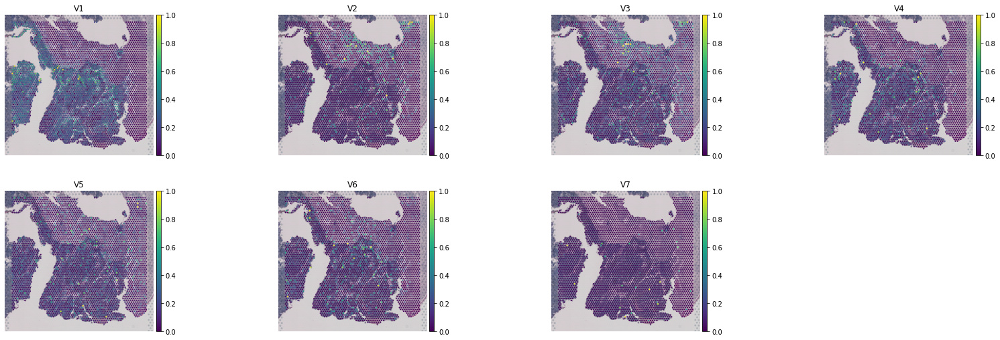

V11M22-348_B1 diff_cytoIC CO39262-296777-2887


INFO:root:1368 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1368 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1368 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.098, KL reg: 0.436
Score: 0.137, KL reg: 0.002
Score: 0.139, KL reg: 0.002
Score: 0.139, KL reg: 0.002
Score: 0.139, KL reg: 0.002
Score: 0.139, KL reg: 0.002
Score: 0.139, KL reg: 0.002
Score: 0.139, KL reg: 0.002
Score: 0.139, KL reg: 0.002
Score: 0.139, KL reg: 0.002


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


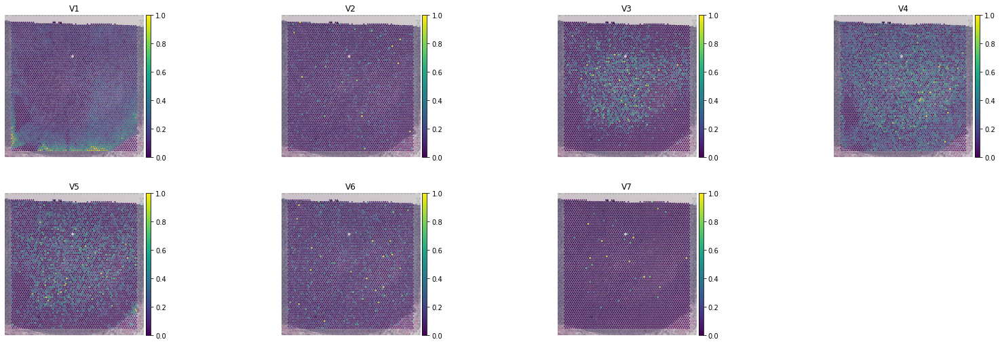

V11L12-058_B1 diff_cytoIC CO39262-296850-2270


INFO:root:1339 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1339 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1339 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.088, KL reg: 0.273
Score: 0.147, KL reg: 0.001
Score: 0.148, KL reg: 0.001
Score: 0.148, KL reg: 0.001
Score: 0.148, KL reg: 0.001
Score: 0.148, KL reg: 0.001
Score: 0.148, KL reg: 0.001
Score: 0.148, KL reg: 0.001
Score: 0.149, KL reg: 0.001
Score: 0.149, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


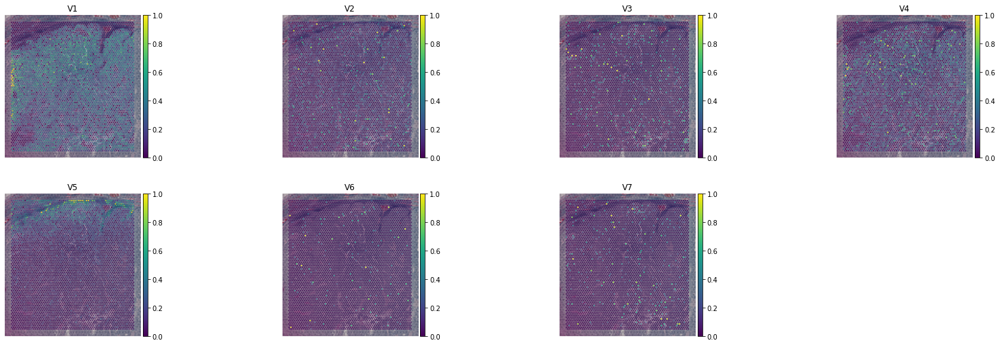

V11M22-348_C1 Undiff_Fib_IRes CO39262-297200-2256


INFO:root:1382 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1382 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1382 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.098, KL reg: 0.333
Score: 0.151, KL reg: 0.001
Score: 0.152, KL reg: 0.001
Score: 0.152, KL reg: 0.000
Score: 0.153, KL reg: 0.000
Score: 0.153, KL reg: 0.000
Score: 0.153, KL reg: 0.000
Score: 0.153, KL reg: 0.000
Score: 0.153, KL reg: 0.000
Score: 0.153, KL reg: 0.000


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


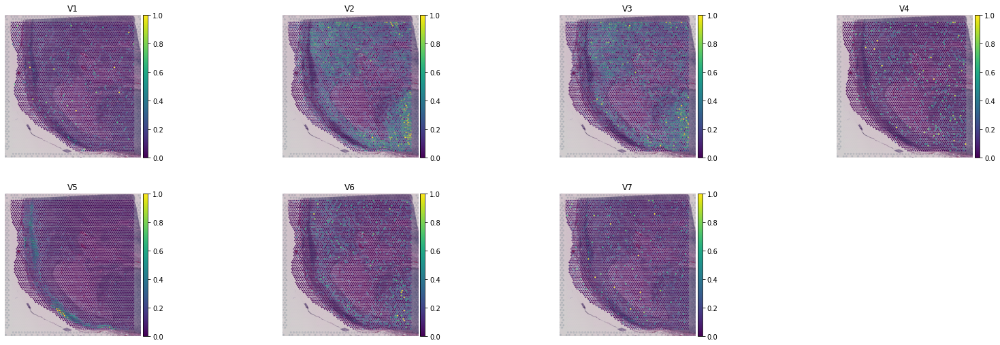

V11M15-034_C1 diff_cytoIC CO39262-295343-3201


INFO:root:1145 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1145 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1145 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.031, KL reg: 0.838
Score: 0.063, KL reg: 0.001
Score: 0.067, KL reg: 0.001
Score: 0.068, KL reg: 0.001
Score: 0.069, KL reg: 0.001
Score: 0.069, KL reg: 0.001
Score: 0.069, KL reg: 0.001
Score: 0.069, KL reg: 0.001
Score: 0.069, KL reg: 0.001
Score: 0.069, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


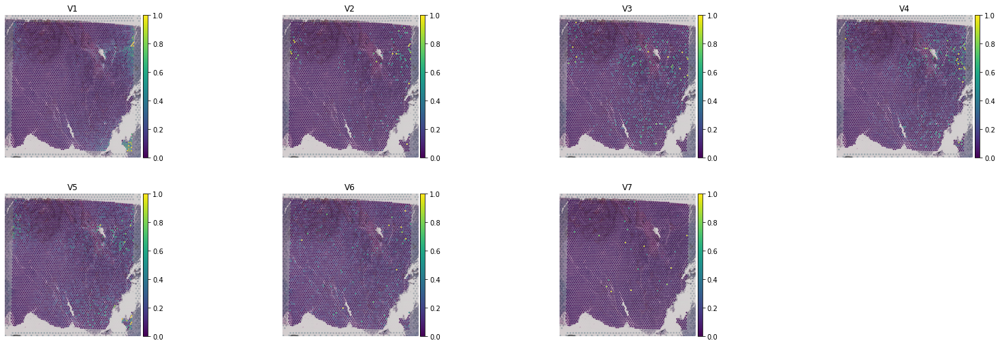

V11M22-347_D1 Undiff_Fib_IRes CO39262-295916-2129


INFO:root:1339 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1339 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1339 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.110, KL reg: 0.331
Score: 0.182, KL reg: 0.003
Score: 0.184, KL reg: 0.003
Score: 0.184, KL reg: 0.003
Score: 0.184, KL reg: 0.003
Score: 0.184, KL reg: 0.003
Score: 0.184, KL reg: 0.003
Score: 0.185, KL reg: 0.003
Score: 0.185, KL reg: 0.003
Score: 0.185, KL reg: 0.003


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


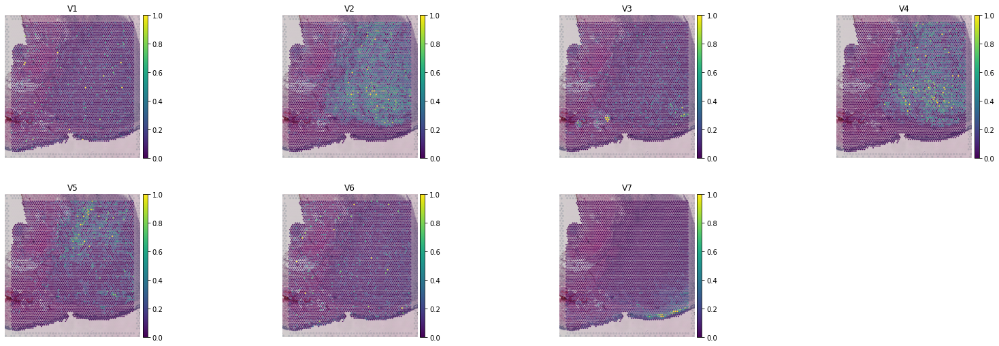

V11L12-114_C1 diff_cytoIC CO39262-296850-2300


INFO:root:1153 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1153 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1153 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.057, KL reg: 0.421
Score: 0.097, KL reg: 0.001
Score: 0.099, KL reg: 0.001
Score: 0.099, KL reg: 0.001
Score: 0.100, KL reg: 0.001
Score: 0.100, KL reg: 0.001
Score: 0.100, KL reg: 0.001
Score: 0.100, KL reg: 0.001
Score: 0.100, KL reg: 0.001
Score: 0.100, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


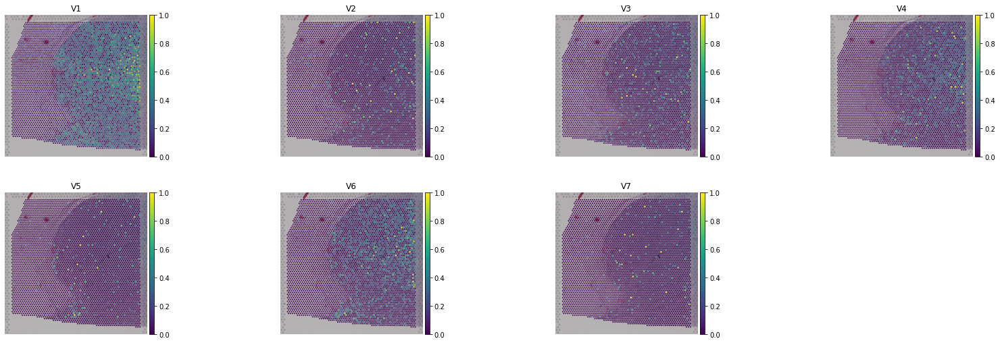

V11Y03-112_A1 diff_cytoIC CO39262-297204-2258


INFO:root:1384 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1384 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1384 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.084, KL reg: 0.411
Score: 0.129, KL reg: 0.001
Score: 0.132, KL reg: 0.001
Score: 0.132, KL reg: 0.001
Score: 0.132, KL reg: 0.001
Score: 0.133, KL reg: 0.001
Score: 0.133, KL reg: 0.001
Score: 0.133, KL reg: 0.001
Score: 0.133, KL reg: 0.001
Score: 0.133, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


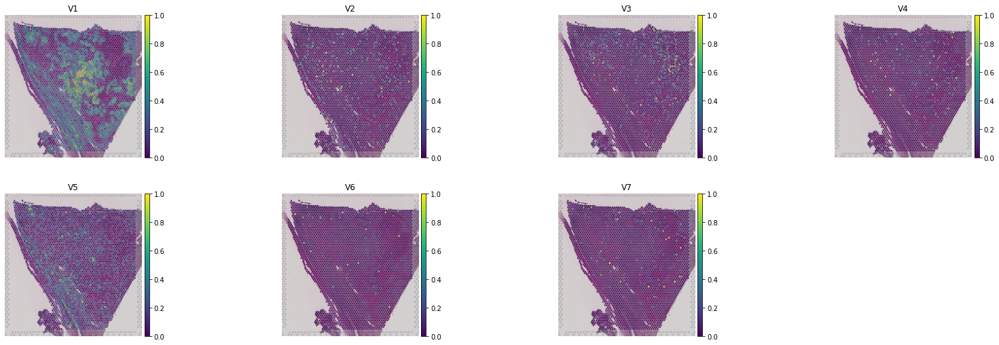

V11Y03-113_B1 diff_cytoIC CO39262-296860-2357


INFO:root:1074 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1074 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1074 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.112, KL reg: 0.241
Score: 0.164, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.166, KL reg: 0.001
Score: 0.166, KL reg: 0.001
Score: 0.166, KL reg: 0.001
Score: 0.166, KL reg: 0.001
Score: 0.166, KL reg: 0.001
Score: 0.166, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


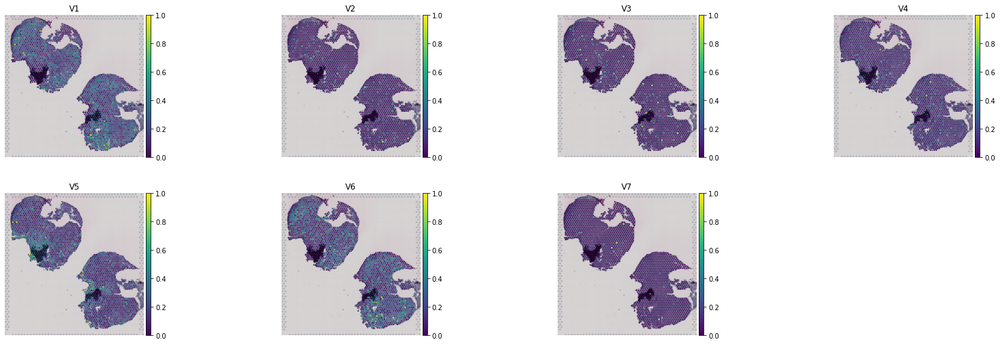

V11M22-346_D1 Undiff_Fib_IRes CO39262-296860-2347


INFO:root:1338 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1338 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1338 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.101, KL reg: 0.324
Score: 0.177, KL reg: 0.005
Score: 0.178, KL reg: 0.005
Score: 0.178, KL reg: 0.005
Score: 0.178, KL reg: 0.005
Score: 0.179, KL reg: 0.005
Score: 0.179, KL reg: 0.005
Score: 0.179, KL reg: 0.005
Score: 0.179, KL reg: 0.005
Score: 0.179, KL reg: 0.005


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


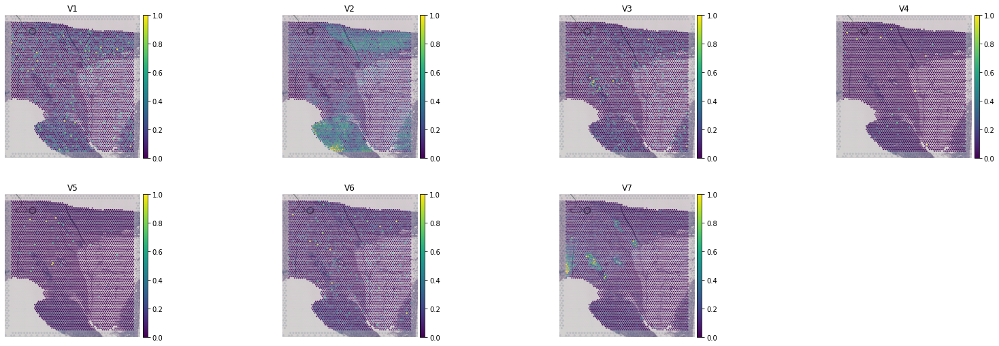

V11M22-346_A1 Undiff_Fib_IRes CO39262-300627-3810


INFO:root:1262 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1262 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1262 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.086, KL reg: 0.632
Score: 0.187, KL reg: 0.001
Score: 0.189, KL reg: 0.001
Score: 0.190, KL reg: 0.001
Score: 0.190, KL reg: 0.001
Score: 0.190, KL reg: 0.001
Score: 0.190, KL reg: 0.001
Score: 0.190, KL reg: 0.001
Score: 0.190, KL reg: 0.001
Score: 0.190, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


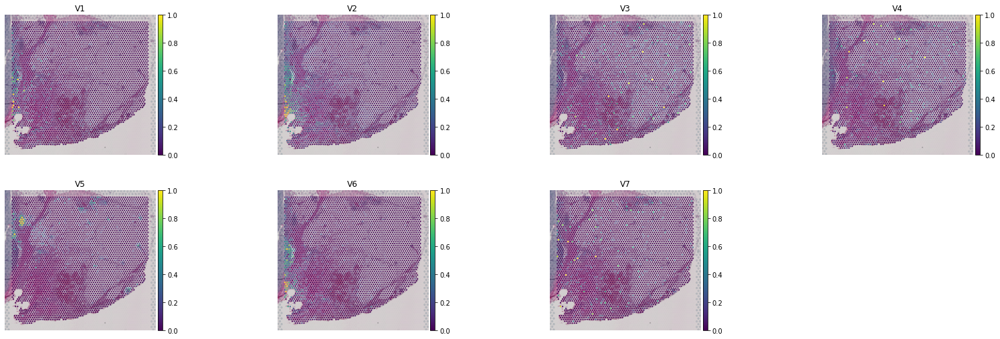

V11M22-346_B1 diff_cytoIC CO39262-295701-2444


INFO:root:1154 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1154 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1154 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.049, KL reg: 1.471
Score: 0.205, KL reg: 0.006
Score: 0.209, KL reg: 0.005
Score: 0.210, KL reg: 0.005
Score: 0.211, KL reg: 0.005
Score: 0.211, KL reg: 0.005
Score: 0.211, KL reg: 0.005
Score: 0.211, KL reg: 0.005
Score: 0.211, KL reg: 0.004
Score: 0.211, KL reg: 0.004


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


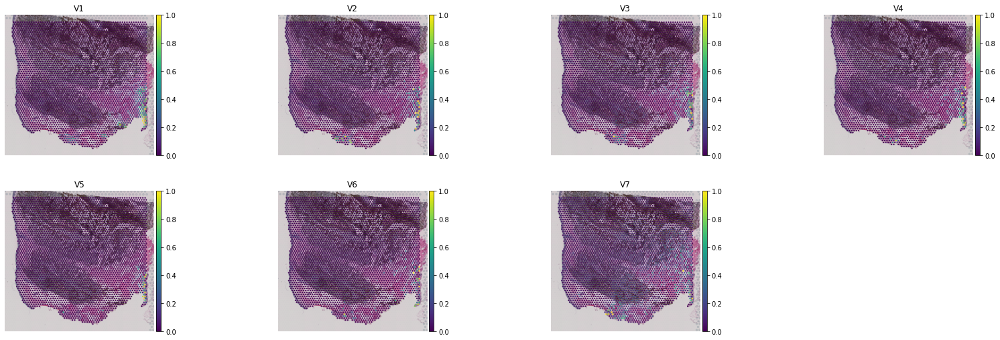

V11L12-058_A1 Undiff_Fib_IRes CO39262-295210-3200


INFO:root:1199 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1199 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1199 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.094, KL reg: 0.496
Score: 0.185, KL reg: 0.001
Score: 0.187, KL reg: 0.001
Score: 0.187, KL reg: 0.001
Score: 0.188, KL reg: 0.001
Score: 0.188, KL reg: 0.000
Score: 0.188, KL reg: 0.000
Score: 0.188, KL reg: 0.000
Score: 0.188, KL reg: 0.000
Score: 0.188, KL reg: 0.000


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


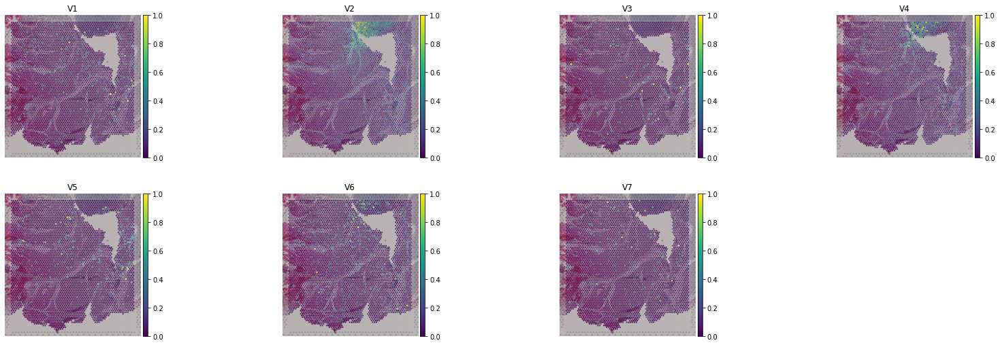

V11L12-058_D1 diff_cytoIC CO39262-296777-2895


INFO:root:1333 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1333 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1333 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.057, KL reg: 0.458
Score: 0.102, KL reg: 0.001
Score: 0.105, KL reg: 0.001
Score: 0.106, KL reg: 0.001
Score: 0.106, KL reg: 0.001
Score: 0.106, KL reg: 0.001
Score: 0.106, KL reg: 0.001
Score: 0.106, KL reg: 0.001
Score: 0.106, KL reg: 0.001
Score: 0.106, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


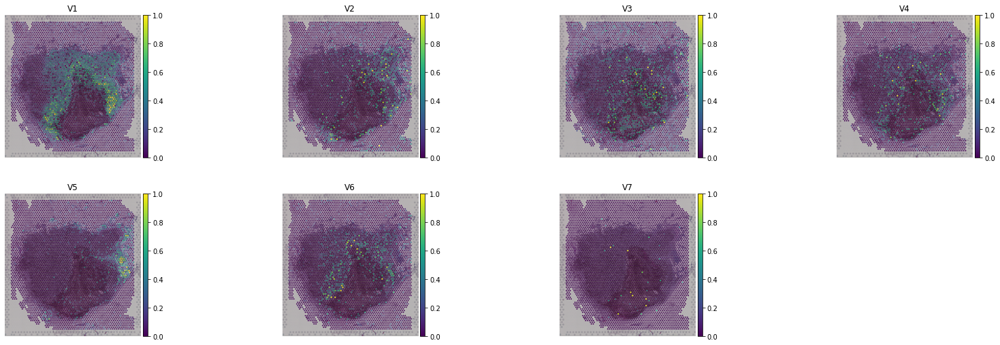

V11Y03-112_B1 diff_cytoIC CO39262-305602-1007


INFO:root:1235 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1235 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1235 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.087, KL reg: 0.583
Score: 0.163, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.166, KL reg: 0.001
Score: 0.166, KL reg: 0.001
Score: 0.166, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


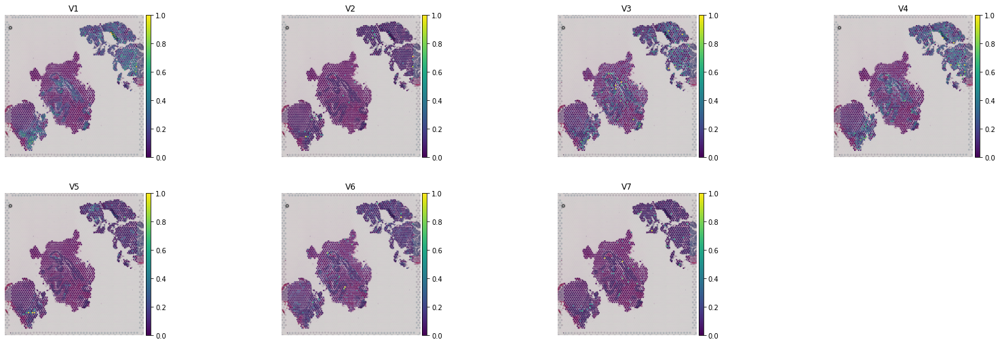

V11Y03-112_D1 diff_cytoIC CO39262-295913-4302


INFO:root:1010 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1010 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1010 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.116, KL reg: 0.476
Score: 0.248, KL reg: 0.006
Score: 0.250, KL reg: 0.006
Score: 0.251, KL reg: 0.005
Score: 0.251, KL reg: 0.005
Score: 0.251, KL reg: 0.005
Score: 0.251, KL reg: 0.005
Score: 0.252, KL reg: 0.005
Score: 0.252, KL reg: 0.005
Score: 0.252, KL reg: 0.005


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


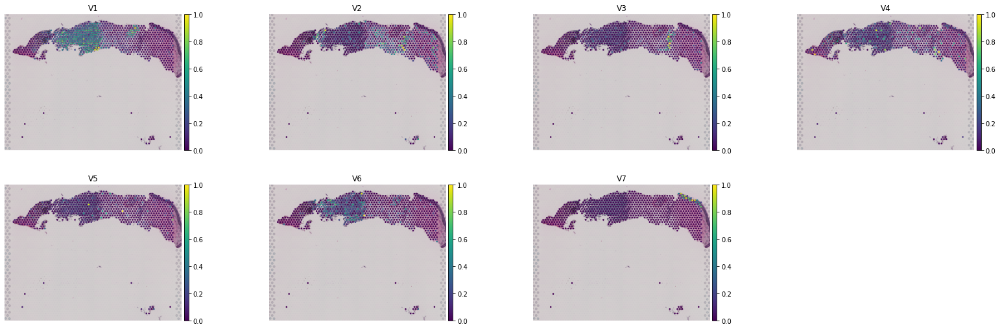

V11M15-037_A1 Undiff_Fib_IRes CO39262-295701-2426


INFO:root:1296 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1296 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1296 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.082, KL reg: 0.608
Score: 0.161, KL reg: 0.001
Score: 0.164, KL reg: 0.001
Score: 0.164, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001
Score: 0.165, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


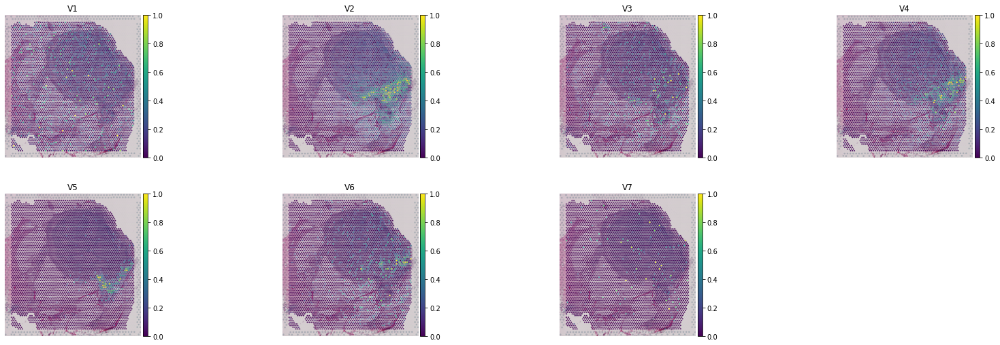

V11Y03-112_C1 diff_cytoIC CO39262-297200-2249


INFO:root:1356 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1356 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1356 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.103, KL reg: 0.262
Score: 0.156, KL reg: 0.001
Score: 0.157, KL reg: 0.001
Score: 0.158, KL reg: 0.001
Score: 0.158, KL reg: 0.001
Score: 0.158, KL reg: 0.001
Score: 0.158, KL reg: 0.001
Score: 0.158, KL reg: 0.001
Score: 0.158, KL reg: 0.001
Score: 0.158, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


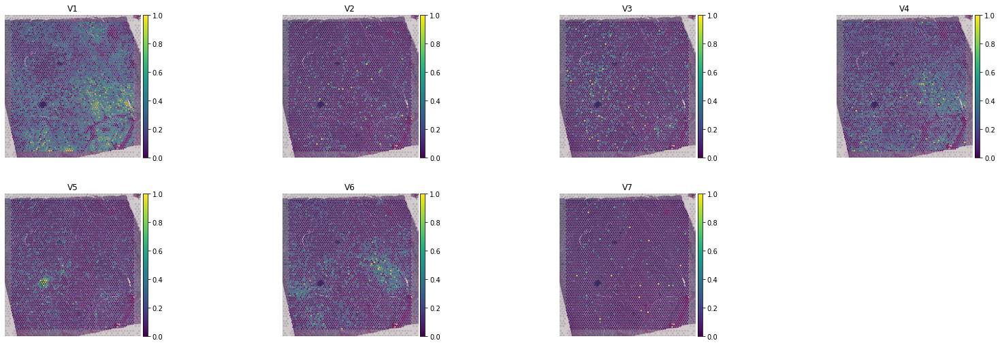

V11Y03-114_D1 diff_cytoIC CO39262-295702-2416


INFO:root:743 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:743 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 743 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.035, KL reg: 0.750
Score: 0.090, KL reg: 0.001
Score: 0.092, KL reg: 0.001
Score: 0.092, KL reg: 0.001
Score: 0.092, KL reg: 0.001
Score: 0.093, KL reg: 0.001
Score: 0.093, KL reg: 0.001
Score: 0.093, KL reg: 0.001
Score: 0.093, KL reg: 0.001
Score: 0.093, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


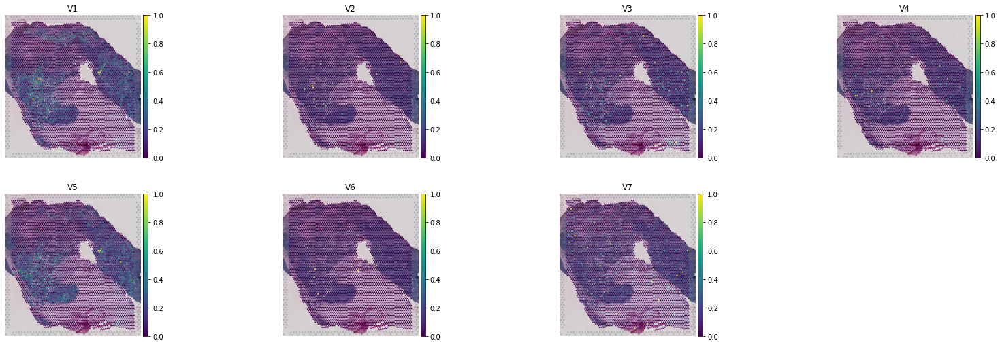

V11L12-114_B1 diff_cytoIC CO39262-300631-3836


INFO:root:1285 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1285 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1285 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.102, KL reg: 0.212
Score: 0.152, KL reg: 0.001
Score: 0.154, KL reg: 0.001
Score: 0.154, KL reg: 0.001
Score: 0.154, KL reg: 0.001
Score: 0.154, KL reg: 0.001
Score: 0.154, KL reg: 0.001
Score: 0.154, KL reg: 0.001
Score: 0.154, KL reg: 0.001
Score: 0.154, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


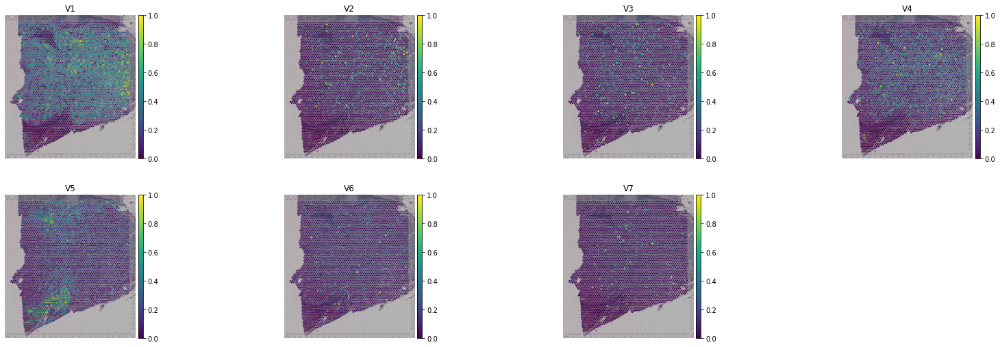

V11M15-033_D1 diff_cytoIC CO39262-297200-2247


INFO:root:1334 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1334 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1334 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.110, KL reg: 0.492
Score: 0.208, KL reg: 0.011
Score: 0.210, KL reg: 0.010
Score: 0.211, KL reg: 0.010
Score: 0.211, KL reg: 0.010
Score: 0.211, KL reg: 0.010
Score: 0.211, KL reg: 0.010
Score: 0.211, KL reg: 0.010
Score: 0.211, KL reg: 0.010
Score: 0.211, KL reg: 0.010


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


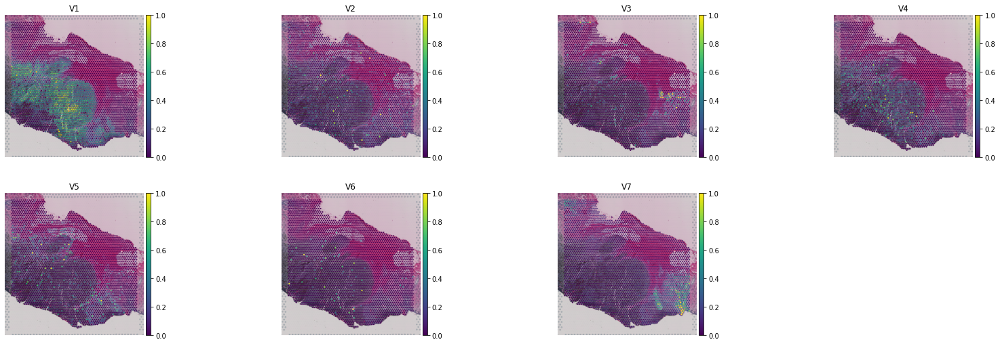

V11M15-035_C1 Undiff_Fib_IRes CO39262-295917-2079


INFO:root:1242 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1242 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1242 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.102, KL reg: 0.521
Score: 0.184, KL reg: 0.001
Score: 0.186, KL reg: 0.001
Score: 0.187, KL reg: 0.000
Score: 0.187, KL reg: 0.000
Score: 0.187, KL reg: 0.000
Score: 0.187, KL reg: 0.000
Score: 0.187, KL reg: 0.000
Score: 0.187, KL reg: 0.000
Score: 0.187, KL reg: 0.000


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


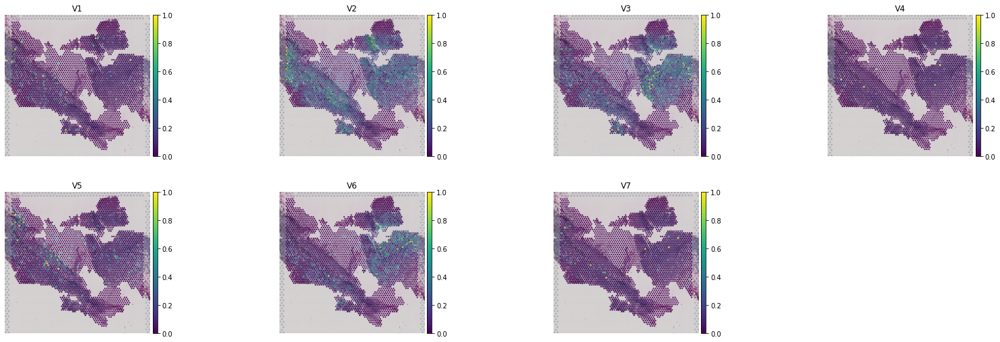

V11M15-035_D1 diff_cytoIC CO39262-295488-2950


INFO:root:1160 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1160 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1160 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.065, KL reg: 0.990
Score: 0.147, KL reg: 0.002
Score: 0.149, KL reg: 0.001
Score: 0.150, KL reg: 0.001
Score: 0.150, KL reg: 0.001
Score: 0.150, KL reg: 0.001
Score: 0.151, KL reg: 0.001
Score: 0.151, KL reg: 0.001
Score: 0.151, KL reg: 0.001
Score: 0.151, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


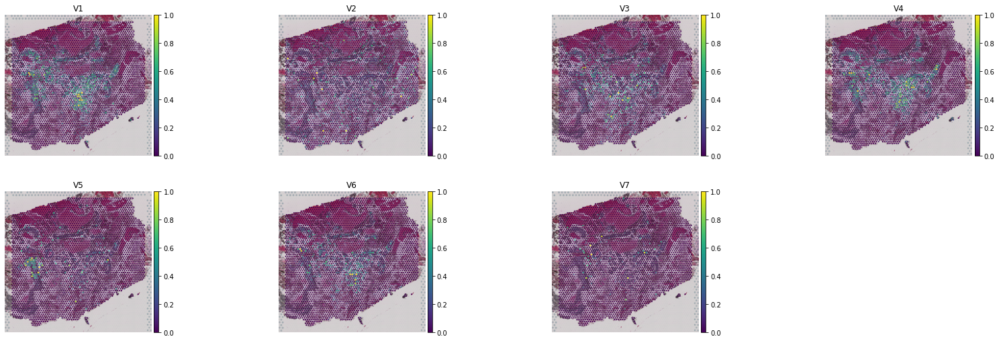

V11Y03-113_A1 diff_cytoIC CO39262-296854-2303


INFO:root:1213 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1213 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1213 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.053, KL reg: 0.481
Score: 0.097, KL reg: 0.001
Score: 0.100, KL reg: 0.001
Score: 0.100, KL reg: 0.001
Score: 0.101, KL reg: 0.001
Score: 0.101, KL reg: 0.001
Score: 0.101, KL reg: 0.001
Score: 0.101, KL reg: 0.001
Score: 0.101, KL reg: 0.001
Score: 0.101, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


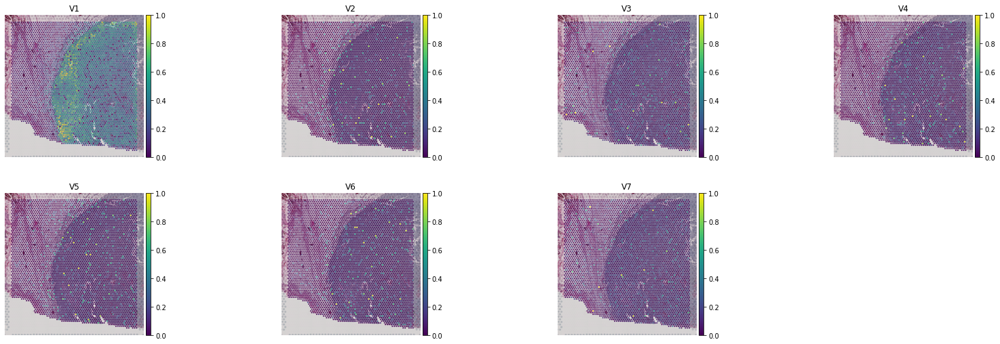

V11M22-347_C1 Undiff_Fib_IRes CO39262-295343-3208


INFO:root:1141 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1141 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1141 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.074, KL reg: 0.446
Score: 0.141, KL reg: 0.001
Score: 0.144, KL reg: 0.001
Score: 0.145, KL reg: 0.001
Score: 0.145, KL reg: 0.001
Score: 0.145, KL reg: 0.001
Score: 0.145, KL reg: 0.001
Score: 0.145, KL reg: 0.001
Score: 0.145, KL reg: 0.001
Score: 0.145, KL reg: 0.001


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


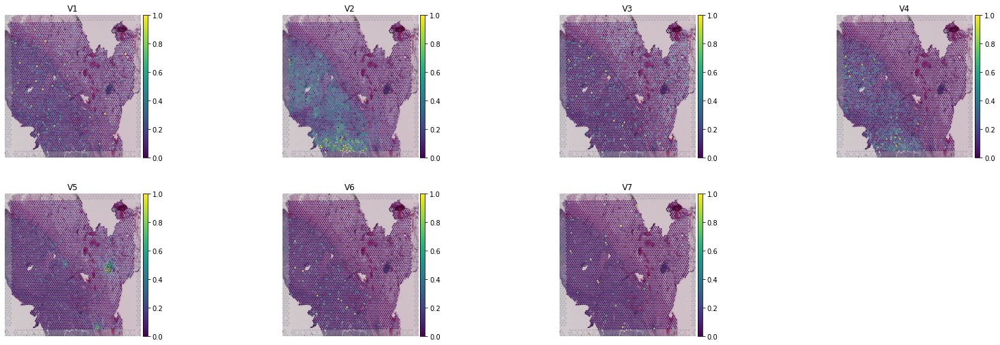

V11M22-346_C1 diff_cytoIC CO39262-295488-2962


INFO:root:1290 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1290 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1290 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.122, KL reg: 0.491
Score: 0.235, KL reg: 0.002
Score: 0.236, KL reg: 0.002
Score: 0.236, KL reg: 0.002
Score: 0.237, KL reg: 0.002
Score: 0.237, KL reg: 0.002
Score: 0.237, KL reg: 0.002
Score: 0.237, KL reg: 0.002
Score: 0.237, KL reg: 0.002
Score: 0.237, KL reg: 0.002


INFO:root:Saving results..
INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


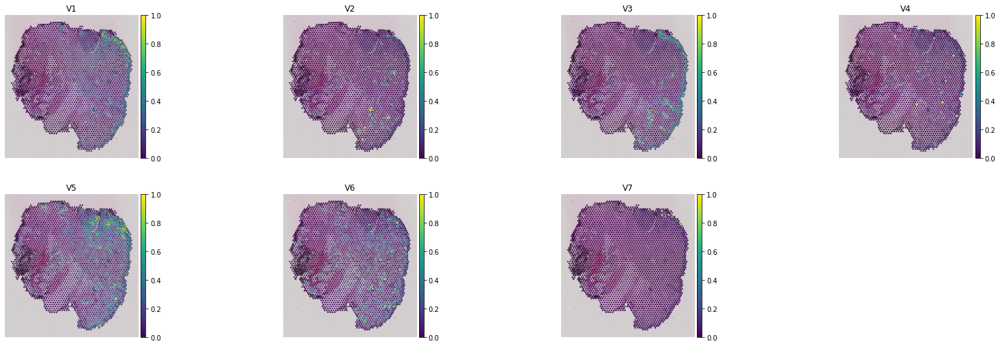

In [12]:
for visium_id in sample_list:
    
    cluster = mapping.loc[visium_id+'/', 'nmf_cluster']
    pid = mapping.loc[visium_id+'/', 'PATIENT_ID']
    sample_name = [sample for sample in nmf_coeffs.columns if int(sample.split('-')[2]) == pid]
    sample_name = sample_name[0]
    cluster = mapping.loc[visium_id+'/', 'nmf_cluster']
    print(visium_id, cluster, sample_name)
    
    ad_sp = make_anndata(st_dir, visium_id)
    ad_sp.var_names_make_unique()
    tg.pp_adatas(ad_sc, ad_sp)
    
    ad_map = tg.map_cells_to_space(adata_sc=ad_sc, 
                                   adata_sp=ad_sp,
                                   mode = 'nmf', 
                                   nmf_coeffs = nmf_coeffs,
                                   sample_name = sample_name,
                                   cluster_label = 'cluster_id')
    
    tg.project_cell_annotations(ad_map, ad_sp, annotation='cluster_id')
    annotation_list = list(pd.unique(ad_sc.obs['cluster_id']))
    tg.plot_cell_annotation_sc(ad_sp, annotation_list,x='x', y='y', perc=0.001)
    plt.savefig(os.path.join(data_path, 'tangram_nmf_WxH', visium_id + '_' + cluster))
    plt.show()

# Scratch

### Run for one sample

In [11]:
visium_id='V11L12-058_A1' # PID 3200
cluster = mapping.loc[visium_id+'/', 'nmf_cluster']
pid = mapping.loc[visium_id+'/', 'PATIENT_ID']

sample_name = [sample for sample in nmf_coeffs.columns if int(sample.split('-')[2]) == pid]
sample_name = sample_name[0]

print(visium_id, cluster, sample_name)

V11L12-058_A1 Undiff_Fib_IRes CO39262-295210-3200


In [12]:
ad_sp = make_anndata(st_dir, visium_id)
ad_sp.var_names_make_unique()
ad_sp

AnnData object with n_obs × n_vars = 4355 × 17922
    obs: 'y', 'x'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [13]:
tg.pp_adatas(ad_sc, ad_sp)

INFO:root:1199 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1199 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [14]:
ad_sp

AnnData object with n_obs × n_vars = 4355 × 16287
    obs: 'y', 'x', 'uniform_density', 'rna_count_based_density'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'training_genes', 'overlap_genes'
    obsm: 'spatial'

In [15]:
ad_map = tg.map_cells_to_space(adata_sc=ad_sc, 
                               adata_sp=ad_sp,
                               mode = 'nmf', 
                               nmf_coeffs = nmf_coeffs,
                               sample_name = sample_name,
                               cluster_label = 'cluster_id')

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1199 genes and rna_count_based density_prior in nmf mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.095, KL reg: 0.370
Score: 0.179, KL reg: 0.000
Score: 0.180, KL reg: 0.000
Score: 0.181, KL reg: 0.000
Score: 0.181, KL reg: 0.000
Score: 0.181, KL reg: 0.000
Score: 0.182, KL reg: 0.000
Score: 0.182, KL reg: 0.000
Score: 0.182, KL reg: 0.000
Score: 0.182, KL reg: 0.000


INFO:root:Saving results..


INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


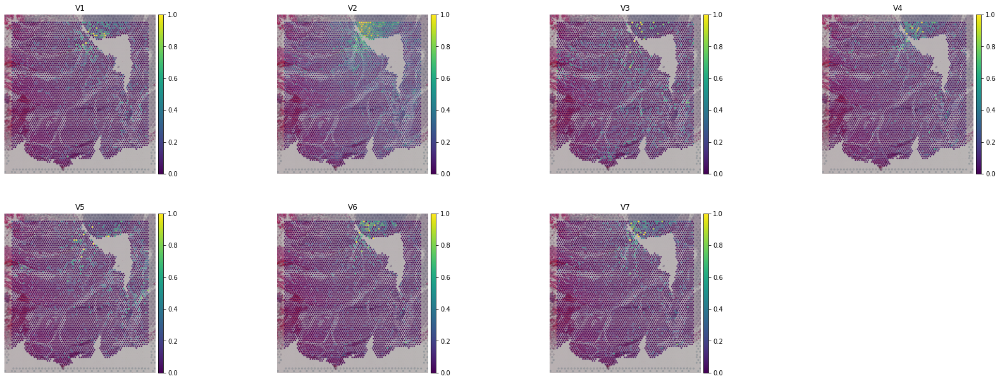

In [16]:
tg.project_cell_annotations(ad_map, ad_sp, annotation='cluster_id')
annotation_list = list(pd.unique(ad_sc.obs['cluster_id']))
tg.plot_cell_annotation_sc(ad_sp, annotation_list,x='x', y='y', perc=0.001)

In [12]:
# run for all samples

# Scratch

### Plotting NMF clusters on visium st: differentiated, metastatic sample
NMF cluster: V1

In [10]:
sample_list = [d for d in os.listdir(st_dir) if os.path.isdir(os.path.join(st_dir, d))]
sample_list[0]

In [38]:
# loading first sample
ad_sp = make_anndata(st_dir, sample_list[0])
print(sample_list[0]) # diff, metastatic

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


V11M15-033_C1


In [31]:
# bulk_cid = pd.read_csv('../priya_analysis/data/bulk_nmf_cid_1500.csv', index_col=0)
# bulk_cid.head(2)

In [32]:
# differentiated, metastatic
# [bulk_cid.loc[sname, 'cluster_id'] for sname in bulk_cid.index if sname.endswith('2231')] # patient id from shreya

In [39]:
# one sample
ad_sp # ~4200 spots to ~17000 genes

AnnData object with n_obs × n_vars = 4204 × 17922
    obs: 'y', 'x'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [41]:
ad_sp.var_names_make_unique()

In [42]:
ad_sp

AnnData object with n_obs × n_vars = 4204 × 17922
    obs: 'y', 'x'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [43]:
'counts are raw'
np.unique(ad_sp.X.toarray()[0,:])

array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
        11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
        22.,  23.,  24.,  25.,  26.,  28.,  29.,  30.,  31.,  32.,  33.,
        34.,  35.,  36.,  37.,  38.,  40.,  41.,  42.,  43.,  44.,  45.,
        47.,  53.,  55.,  56.,  57.,  59.,  60.,  65.,  69.,  71.,  73.,
        84.,  86.,  96., 119., 147.], dtype=float32)

### Read sc data and markers

In [44]:
# sc_path = '/gstore/scratch/90/resbioai/melanoma-sc'
ad_sc = sc.read_h5ad('data/melanoma_nmf_w_1500_norm10k.h5ad')
# markers = pd.read_csv(os.path.join(sc_path, 'markers.csv'), index_col=0)['0'].values

In [45]:
ad_sc

AnnData object with n_obs × n_vars = 7 × 1500
    obs: 'cluster_id'

In [46]:
# len(markers)

In [47]:
tg.pp_adatas(ad_sc, ad_sp) # this step also removes all zero values genes

INFO:root:1358 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1358 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [48]:
ad_sc

AnnData object with n_obs × n_vars = 7 × 1500
    obs: 'cluster_id'
    var: 'n_cells'
    uns: 'training_genes', 'overlap_genes'

In [49]:
ad_sp

AnnData object with n_obs × n_vars = 4204 × 17575
    obs: 'y', 'x', 'uniform_density', 'rna_count_based_density'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'training_genes', 'overlap_genes'
    obsm: 'spatial'

In [50]:
assert ad_sc.uns['training_genes'] == ad_sp.uns['training_genes']

In [51]:
ad_map = tg.map_cells_to_space(
    adata_sc=ad_sc,
    adata_sp=ad_sp,
    #device='cpu',
#     mode='clusters',
    cluster_label = 'cluster_id',
    device='cuda:0',
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1358 genes and rna_count_based density_prior in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.105, KL reg: 0.371
Score: 0.159, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001


INFO:root:Saving results..


INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


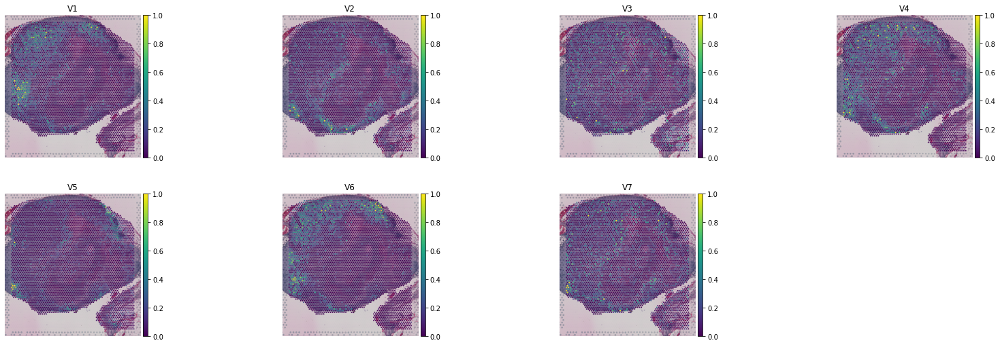

In [52]:
tg.project_cell_annotations(ad_map, ad_sp, annotation='cluster_id')
annotation_list = list(pd.unique(ad_sc.obs['cluster_id']))
tg.plot_cell_annotation_sc(ad_sp, annotation_list,x='x', y='y', perc=0.001)

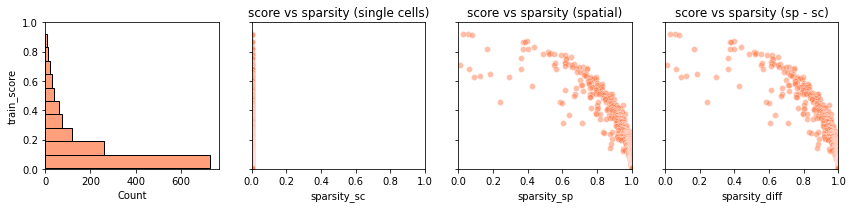

In [53]:
tg.plot_training_scores(ad_map, bins=10, alpha=.5)

### Plotting NMF clusters on visium st: undifferentiated, metastatic sample
NMF cluster: V2

In [55]:
# loading one sample
ad_sp = make_anndata(st_dir, 'V11L12-058_C1') # sample name from Shreya

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [56]:
# one sample
ad_sp

AnnData object with n_obs × n_vars = 3924 × 17922
    obs: 'y', 'x'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [57]:
ad_sp.var_names_make_unique()

In [58]:
ad_sp

AnnData object with n_obs × n_vars = 3924 × 17922
    obs: 'y', 'x'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [59]:
'counts are raw'
np.unique(ad_sp.X.toarray()[0,:])

array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
        11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
        22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  33.,  35.,  37.,
        39.,  40.,  42.,  44.,  45.,  48.,  57.,  65.,  67.,  75.,  84.,
        94., 164., 166., 400.], dtype=float32)

### Read sc data and markers

In [62]:
# sc_path = '/gstore/scratch/90/resbioai/melanoma-sc'
ad_sc = sc.read_h5ad('data/melanoma_nmf_w_1500_norm10k.h5ad')
# markers = pd.read_csv(os.path.join(sc_path, 'markers.csv'), index_col=0)['0'].values

In [63]:
ad_sc

AnnData object with n_obs × n_vars = 7 × 1500
    obs: 'cluster_id'

In [64]:
# len(markers)

In [65]:
tg.pp_adatas(ad_sc, ad_sp) # this step also removes all zero values genes

INFO:root:1351 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:1351 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [66]:
ad_sc

AnnData object with n_obs × n_vars = 7 × 1500
    obs: 'cluster_id'
    var: 'n_cells'
    uns: 'training_genes', 'overlap_genes'

In [67]:
ad_sp

AnnData object with n_obs × n_vars = 3924 × 17375
    obs: 'y', 'x', 'uniform_density', 'rna_count_based_density'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'training_genes', 'overlap_genes'
    obsm: 'spatial'

In [68]:
assert ad_sc.uns['training_genes'] == ad_sp.uns['training_genes']

In [69]:
ad_map = tg.map_cells_to_space(
    adata_sc=ad_sc,
    adata_sp=ad_sp,
    #device='cpu',
#     mode='clusters',
    cluster_label = 'cluster_id',
    device='cuda:0',
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 1351 genes and rna_count_based density_prior in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.128, KL reg: 0.250
Score: 0.185, KL reg: 0.002
Score: 0.187, KL reg: 0.002
Score: 0.187, KL reg: 0.002
Score: 0.188, KL reg: 0.002
Score: 0.188, KL reg: 0.002
Score: 0.188, KL reg: 0.002
Score: 0.188, KL reg: 0.002
Score: 0.188, KL reg: 0.002
Score: 0.188, KL reg: 0.002


INFO:root:Saving results..


INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


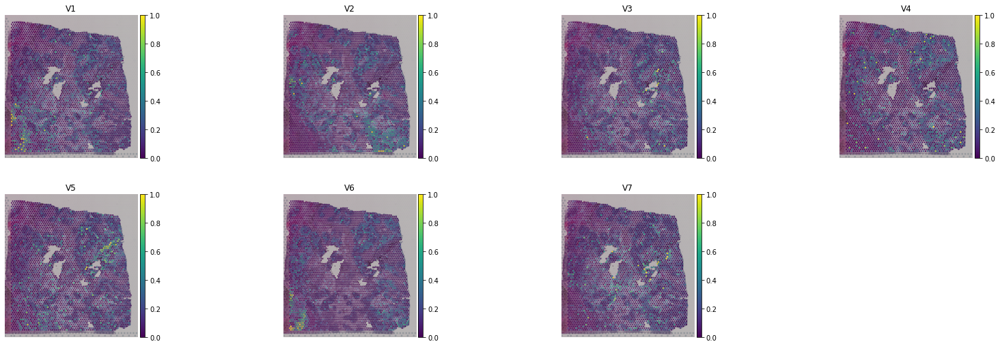

In [70]:
tg.project_cell_annotations(ad_map, ad_sp, annotation='cluster_id')
annotation_list = list(pd.unique(ad_sc.obs['cluster_id']))
tg.plot_cell_annotation_sc(ad_sp, annotation_list,x='x', y='y', perc=0.001)

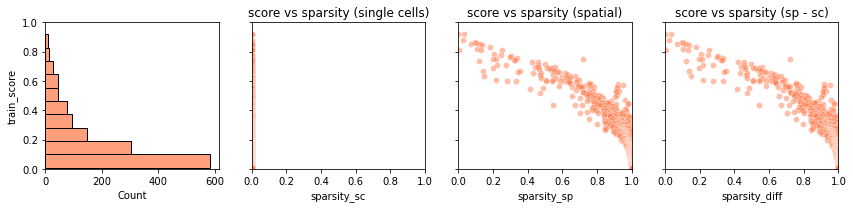

In [91]:
tg.plot_training_scores(ad_map, bins=10, alpha=.5)

In [58]:
# ad_ge = tg.project_genes(adata_map=ad_map, adata_sc=ad_sc)
# ad_ge

In [59]:
# 'plotting a few genes'
# genes = ['axl', 'mitf']
# tg.plot_genes_sc(genes, adata_measured=ad_sp, adata_predicted=ad_ge, perc = 0.001, return_figure=False)

In [60]:
# df_all_genes = tg.compare_spatial_geneexp(ad_ge, ad_sp, ad_sc)
# df_all_genes

In [61]:
# tg.plot_auc(df_all_genes)

In [62]:
# 'store hi-res in container'
# image_array = ad_sp.uns['spatial']['V11M15-033_C1']['images']['hires']
# img = sq.im.ImageContainer(img = image_array)

In [63]:
# crop = img.crop_corner(200,200,600)

In [64]:
# crop

In [65]:
# 'geq = False for H&E'
# sq.im.process(img=crop, layer="image", method="smooth", sigma=4)
# sq.im.segment(
#     img=crop,
#     layer="image_smooth",
#     method="watershed",
#     thresh=0.5, 
#     geq=False
# )

In [66]:
# crop

In [67]:
# fig, axes = plt.subplots(1, 2, figsize=(10,10))
# crop.show("image", channel=0, ax=axes[0])
# _ = axes[0].set_title("H&E")
# crop.show("segmented_watershed", cmap="jet", interpolation="none", ax=axes[1])
# _ = axes[1].set_title("segmentation")


In [68]:
# sns.histplot(np.array(crop["image_smooth"]).flatten(), bins=50)